In [1]:
from yahoo_fin.stock_info import get_data
from datetime import date
import plotly.express as px
import pandas as pd
import numpy as np
from pathlib import Path
import csv
import seaborn as sns
import plotly.graph_objects as go
import plotly.figure_factory as ff
%matplotlib inline


today = date.today()
spy = get_data("spy", start_date="01/03/2015", end_date=today, index_as_date = True, interval="1d")
xle = get_data("xle", start_date="01/03/2015", end_date=today, index_as_date = True, interval="1d")
gold = get_data("GLD", start_date="01/03/2015", end_date=today, index_as_date = True, interval="1d")
tlt = get_data("tlt", start_date="01/03/2015", end_date=today, index_as_date = True, interval="1d")
usd = get_data("tlt", start_date="01/03/2015", end_date=today, index_as_date = True, interval="1d")

In [2]:
# @TODO: Set file paths for btc_data.csv and eth_data.csv
btc_filepath = Path('Resources/BTC-USD.csv')
btc_df = pd.read_csv(btc_filepath, index_col="Date", infer_datetime_format=True, parse_dates=True)

btc_df.head()


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2014-09-17,465.864014,468.174011,452.421997,457.334015,457.334015,21056800.0
2014-09-18,456.859985,456.859985,413.104004,424.440002,424.440002,34483200.0
2014-09-19,424.102997,427.834991,384.532013,394.795990,394.795990,37919700.0
2014-09-20,394.673004,423.295990,389.882996,408.903992,408.903992,36863600.0
2014-09-21,408.084991,412.425995,393.181000,398.821014,398.821014,26580100.0


In [3]:
btc_df.sort_index(inplace=True)
btc_df.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2014-09-17,465.864014,468.174011,452.421997,457.334015,457.334015,21056800.0
2014-09-18,456.859985,456.859985,413.104004,424.440002,424.440002,34483200.0
2014-09-19,424.102997,427.834991,384.532013,394.795990,394.795990,37919700.0
2014-09-20,394.673004,423.295990,389.882996,408.903992,408.903992,36863600.0
2014-09-21,408.084991,412.425995,393.181000,398.821014,398.821014,26580100.0


In [4]:
eth_filepath = Path('Resources/ETH-USD.csv')
eth_df = pd.read_csv(eth_filepath, index_col="Date", infer_datetime_format=True, parse_dates=True)

eth_df.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2015-08-07,2.831620,3.536610,2.521120,2.772120,2.772120,164329.0
2015-08-08,2.793760,2.798810,0.714725,0.753325,0.753325,674188.0
2015-08-09,0.706136,0.879810,0.629191,0.701897,0.701897,532170.0
2015-08-10,0.713989,0.729854,0.636546,0.708448,0.708448,405283.0
2015-08-11,0.708087,1.131410,0.663235,1.067860,1.067860,1463100.0


In [5]:
#fig = px.line(spy['close'], labels={ 'close' : 'SPY CLOSE'})
#fig.show()

In [6]:
#gold.head()

In [7]:
#dxy = get_data("dxy", start_date="01/03/2015", end_date=today, index_as_date = True, interval="1d")
#dxy['close'].plot(figsize=(20,10))

In [8]:
column = ['BTC', 'ETH', 'SPY', 'XLE', 'GLD', 'TLT']

combined_df = pd.concat([btc_df['Close'], eth_df['Close'], spy['close'], xle['close'], gold['close'], tlt['close']], axis="columns", join="inner")
combined_df.columns = column
combined_df.head()

,BTC,ETH,SPY,XLE,GLD,TLT
2015-08-07,279.584991,2.772120,207.949997,67.029999,104.650002,124.339996
2015-08-10,264.470001,0.708448,210.570007,69.169998,105.720001,122.800003
2015-08-11,270.385986,1.067860,208.669998,69.300003,106.260002,124.750000
2015-08-12,266.376007,1.217440,208.919998,70.559998,107.750000,124.070000
2015-08-13,264.079987,1.827670,208.660004,69.489998,106.860001,123.669998


In [9]:
combined_df.isnull().sum()

BTC    5
ETH    5
SPY    0
XLE    0
GLD    0
TLT    0
dtype: int64

In [10]:
portfolio_returns  = combined_df.dropna()

In [11]:
portfolio_returns.isnull().sum()

BTC    0
ETH    0
SPY    0
XLE    0
GLD    0
TLT    0
dtype: int64

In [12]:
portfolio_returns = portfolio_returns.pct_change()

In [13]:
portfolio_returns  = portfolio_returns.dropna()

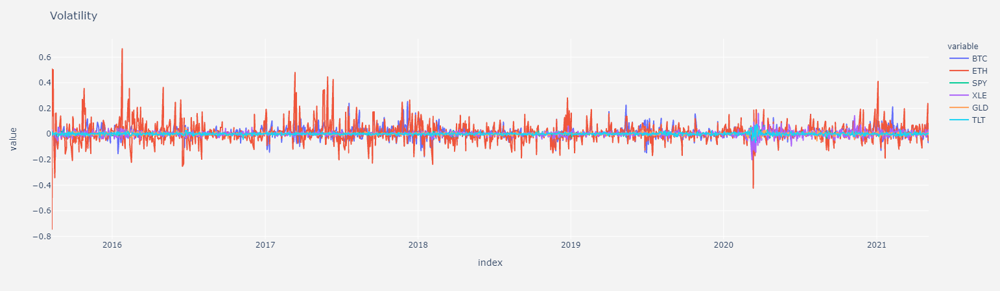

In [14]:
fig = px.line(portfolio_returns)
fig.update_layout(
    title='Volatility',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
)
fig.show()

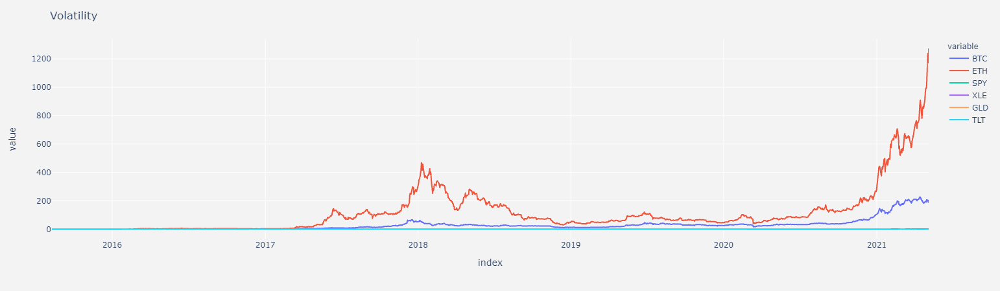

In [15]:
# Calculate cumulative returns of all portfolios
cumulative_returns = (1 + portfolio_returns).cumprod()
# Plot cumulative returns
fig = px.line(cumulative_returns)
fig.update_layout(
    title='Volatility',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
)
fig.show()

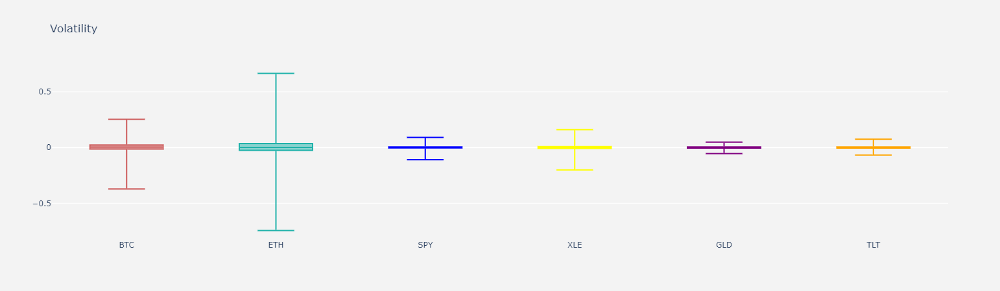

In [16]:
fig = go.Figure()
fig.add_trace(go.Box(y=portfolio_returns['BTC'], name='BTC',
                marker_color = 'indianred', boxpoints=False))
fig.add_trace(go.Box(y=portfolio_returns['ETH'], name = 'ETH',
                marker_color = 'lightseagreen', boxpoints=False))
fig.add_trace(go.Box(y=portfolio_returns['SPY'], name='SPY',
                marker_color = 'blue', boxpoints=False))
fig.add_trace(go.Box(y=portfolio_returns['XLE'], name = 'XLE',
                marker_color = 'yellow', boxpoints=False))
fig.add_trace(go.Box(y=portfolio_returns['GLD'], name='GLD',
                marker_color = 'purple', boxpoints=False))
fig.add_trace(go.Box(y=portfolio_returns['TLT'], name = 'TLT',
                marker_color = 'orange', boxpoints=False))

fig.update_layout(
    title='Volatility',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=False
)

fig.show()

In [17]:
volatility = portfolio_returns.std()
volatility

BTC    0.046724
ETH    0.081419
SPY    0.011801
XLE    0.020487
GLD    0.008831
TLT    0.008719
dtype: float64

In [18]:
volatility = portfolio_returns.std() * np.sqrt(252)
volatility

BTC    0.741721
ETH    1.292482
SPY    0.187340
XLE    0.325214
GLD    0.140186
TLT    0.138411
dtype: float64

<AxesSubplot:>

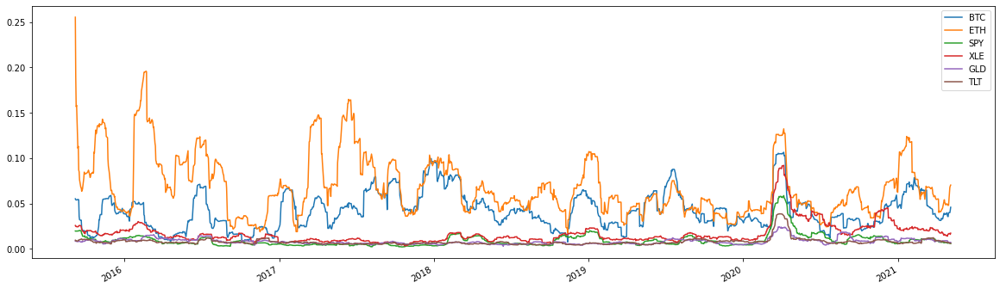

In [19]:
# Calculate the rolling standard deviation for all portfolios using a 21-day window
roll = portfolio_returns.rolling(window=21).std()
# Plot the rolling standard deviation
portfolio_returns.rolling(window=21).std().plot(figsize=(20,6))

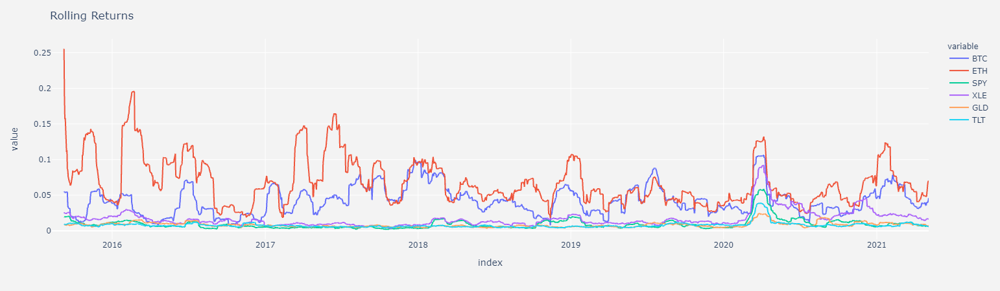

In [20]:
fig = px.line(roll)
fig.update_layout(
    title='Rolling Returns',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
)
fig.show()

In [21]:
# Calculate the correlation
price_correlation = portfolio_returns.corr()
# Display de correlation matrix
price_correlation

,BTC,ETH,SPY,XLE,GLD,TLT
BTC,1.000000,0.478717,0.142542,0.118354,0.104796,-0.029885
ETH,0.478717,1.000000,0.111941,0.082284,0.084387,-0.006073
SPY,0.142542,0.111941,1.000000,0.718332,-0.007816,-0.394084
XLE,0.118354,0.082284,0.718332,1.000000,-0.015398,-0.342205
GLD,0.104796,0.084387,-0.007816,-0.015398,1.000000,0.325467
TLT,-0.029885,-0.006073,-0.394084,-0.342205,0.325467,1.000000


In [22]:
# Use `ewm` to calculate the rolling window
ewm_calc = portfolio_returns.ewm(halflife=21).mean().head()

<AxesSubplot:>

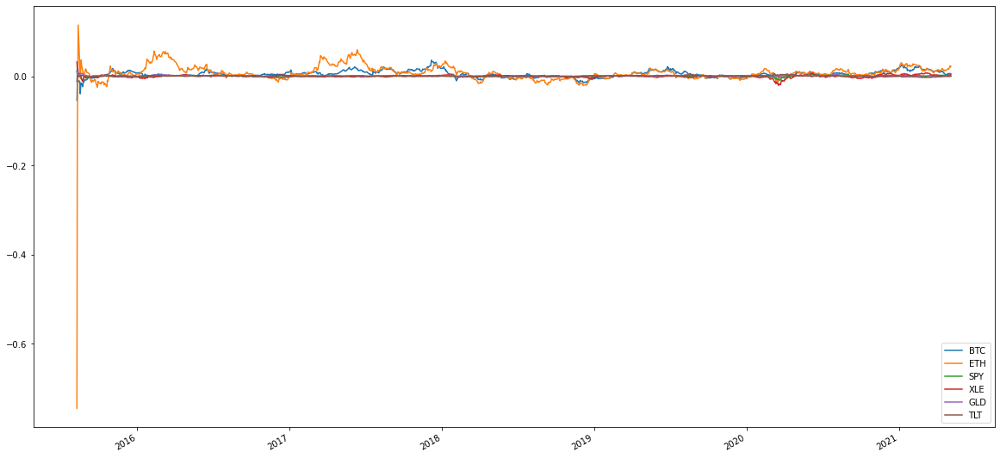

In [23]:
portfolio_returns.ewm(halflife=21).mean().plot(figsize=(20, 10))

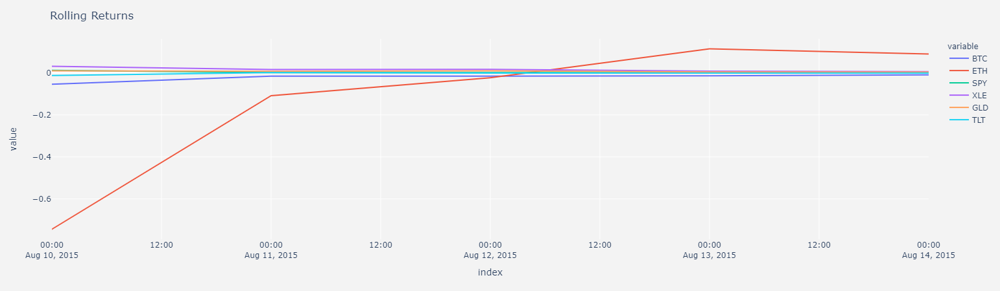

In [24]:
fig = px.line(ewm_calc)
fig.update_layout(
    title='Rolling Returns',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
)
fig.show()

In [26]:
# Annualized Sharpe Ratios
sharpe_ratios = (portfolio_returns.mean() * 252) / (portfolio_returns.std() * np.sqrt(252))
sharpe_ratios[BTC]


NameError: name 'BTC' is not defined

<AxesSubplot:>

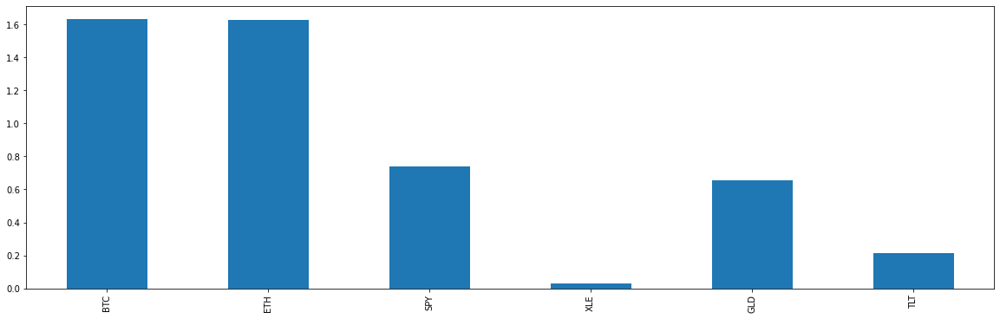

In [27]:
# Visualize the sharpe ratios as a bar plot
sharpe_ratios.plot(kind='bar',figsize=(20,6))

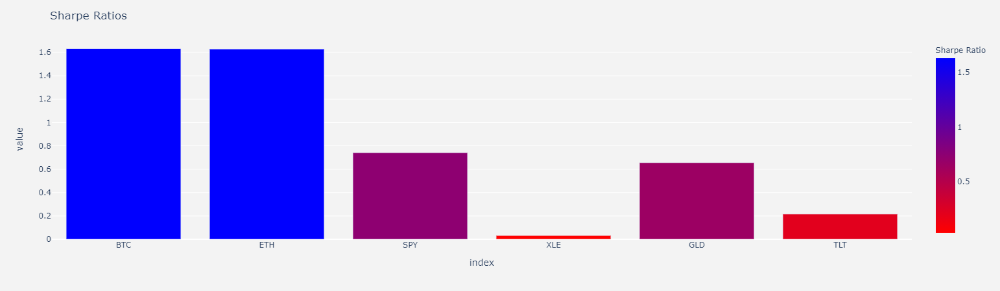

In [28]:
fig = px.bar(sharpe_ratios,labels=dict(x="Assets", y="Sharpe Ratio", color="Sharpe Ratio"),color = sharpe_ratios, color_continuous_scale='Bluered_r')
fig.update_layout(
    title='Sharpe Ratios',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
)
fig.show()

In [29]:
# Calculate and plot the correlation
price_correlation_new = portfolio_returns.corr()
# Display de correlation matrix
price_correlation_new

,BTC,ETH,SPY,XLE,GLD,TLT
BTC,1.000000,0.478717,0.142542,0.118354,0.104796,-0.029885
ETH,0.478717,1.000000,0.111941,0.082284,0.084387,-0.006073
SPY,0.142542,0.111941,1.000000,0.718332,-0.007816,-0.394084
XLE,0.118354,0.082284,0.718332,1.000000,-0.015398,-0.342205
GLD,0.104796,0.084387,-0.007816,-0.015398,1.000000,0.325467
TLT,-0.029885,-0.006073,-0.394084,-0.342205,0.325467,1.000000


<AxesSubplot:>

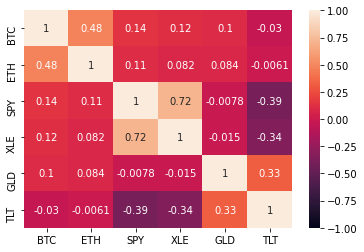

In [30]:
sns.heatmap(price_correlation_new, vmin=-1, vmax=1,annot=True)

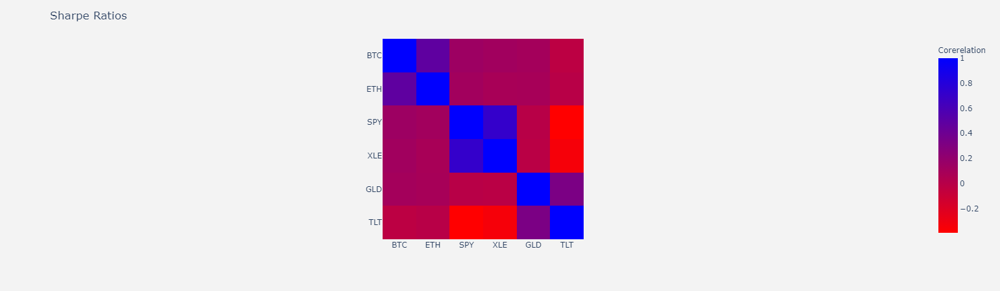

In [31]:
fig = px.imshow(price_correlation_new, color_continuous_scale='Bluered_r', labels = dict(color='Corerelation'))
fig.update_layout(
    title='Sharpe Ratios',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
)
fig.show()

<AxesSubplot:ylabel='Frequency'>

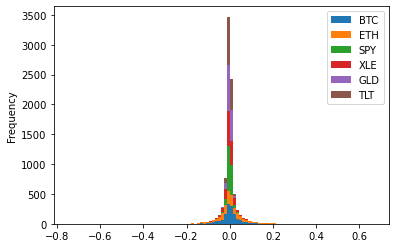

In [32]:
# Distribution Histogram

portfolio_returns.plot.hist(stacked=True, bins=100)



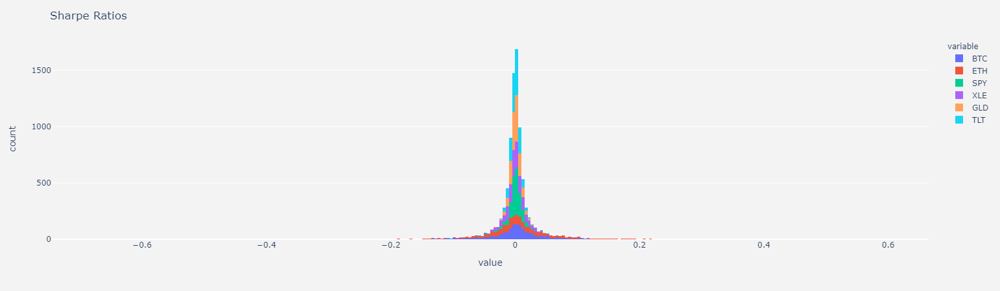

In [33]:
fig = px.histogram(portfolio_returns)
fig.update_layout(
    title='Sharpe Ratios',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True,
    barmode = 'stack'
)
fig.show()

In [34]:
# Set weights
weights = [0,0,1/4,1/4,1/4,1/4]

# Calculate portfolio return

portfolio_returns_weight= portfolio_returns.dot(weights)
# portfolio_returns_new.set_index('Date')

portfolio_returns_weight.dropna()

# Display sample data
portfolio_returns_weight.head()

2015-08-10    0.010591
2015-08-11    0.003461
2015-08-12    0.006988
2015-08-13   -0.006973
2015-08-14    0.000934
dtype: float64

In [36]:
combined_df_MC = combined_df.dropna()

In [37]:
from MCForecastTools import MCSimulation
index_names = [
["BTC", "ETH",  "SPY",  "XLE",  "GLD",  "TLT"],
["close", "close","close","close","close","close"]
]
index_tuples = list(zip(*index_names))
new_index = pd.MultiIndex.from_tuples(index_tuples,names=["first", "second"])
combined_df_MC.columns = new_index

In [38]:
MC_thirty_weights_2 = MCSimulation(
    combined_df_MC,
    weights = [.05,.05,.45,0,0,.45],
    num_simulation = 200,
    num_trading_days = 252*5
)

In [47]:
mc_px = MC_thirty_weights_2.calc_cumulative_return()
mc_px

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.


,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.007777,0.994568,1.001928,1.011476,1.007940,1.013178,1.007428,1.007054,0.995912,0.998042,...,1.008685,1.005979,0.991998,0.999183,0.988084,0.985692,0.992725,0.998933,0.996864,1.000909
2,1.003875,1.003016,0.996151,1.011764,1.006673,1.025448,1.018306,1.004883,0.994307,1.003015,...,1.020273,1.008080,1.001676,0.990563,0.985197,0.985730,1.004795,0.996772,0.990365,1.008790
3,1.007840,0.991578,0.996199,1.006354,1.000254,1.024146,1.020908,0.994848,0.988576,1.022042,...,1.021697,1.022269,0.989413,0.989329,0.988474,0.976103,0.993540,1.003854,0.989593,1.002635
4,0.994308,0.996499,0.983262,1.013261,1.001893,1.033441,1.007022,0.988426,0.994834,1.017319,...,1.031197,1.030073,0.983873,0.969790,0.990576,0.966366,1.008735,1.003573,0.991614,1.012059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,3.370053,2.722344,3.690737,2.763698,3.871248,4.535827,2.927411,2.836137,3.305946,3.559093,...,2.510960,3.326619,3.588016,4.932963,4.678056,3.003215,5.631523,3.166590,3.529189,3.779633
1257,3.327543,2.726920,3.653984,2.740021,3.832320,4.596307,2.947080,2.830880,3.292482,3.541191,...,2.493364,3.300548,3.627920,4.985469,4.716769,2.996621,5.641957,3.202999,3.504110,3.786891
1258,3.279939,2.702116,3.667552,2.760067,3.856792,4.653165,2.942913,2.861004,3.270183,3.551044,...,2.472102,3.368100,3.640660,5.007911,4.691979,3.005303,5.627630,3.215057,3.517958,3.793045
1259,3.247319,2.727878,3.641351,2.757955,3.907810,4.607618,2.986092,2.809523,3.243582,3.543392,...,2.470683,3.379616,3.612844,4.936901,4.711226,3.033637,5.634694,3.230763,3.506822,3.825337


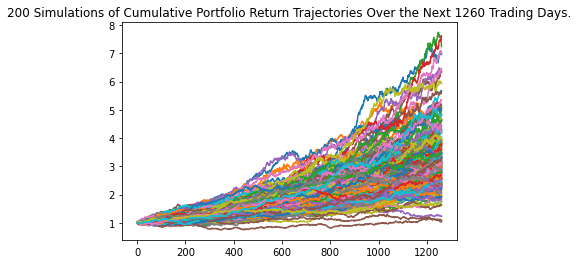

In [40]:
line_plot = MC_thirty_weights_2.plot_simulation()

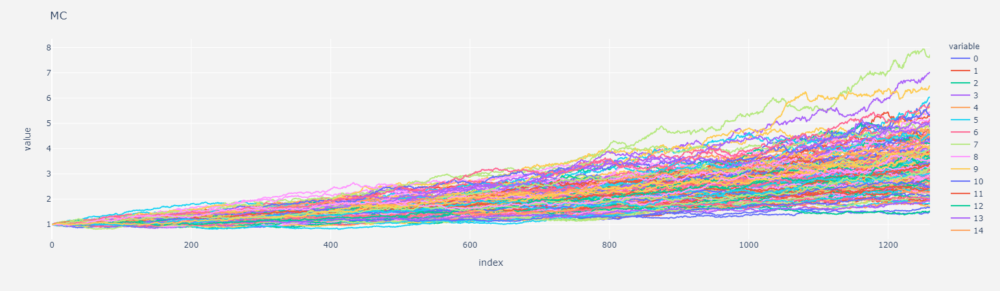

In [48]:
fig = px.line(mc_px)
fig.update_layout(
    title='MC',
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=True
)
fig.show()